# Boston Bike Lane Accidents
*By: Toby Mallon and Kenneth Xiong*

## Introduction
The City of Boston has set for itself an objective of eight percent of commutes be by bicycle by 2030. However, it is currently no where near that goal. Recent surveys peg the percentage of daily commutes on bicycles to be somewhere around 2 percent.

Increasing bicycle ridership is crucial for the cities health. Not only does it decrease the reliance on cars, which lowers the cities carbon footprint as well as the need for expensive parking spaces. It also fills in crucial gaps for when the T is slow, shut down, or unpredictable. Not only this, but adding bicycles improves the vibrancy of street life, which could be a potential benefit for neighborhood stores and resturants.

When Bostonians were asked about why they don't bike more frequently, a common response is that they didn't feel safe riding a bike around Boston. This computational essay seeks to expand on this claim which is based on purely anecdotal evidence. We attempt to charactize which bikes lanes are most dangerous to bikers or if they even help aid in bike safety.

To begin answering this question, we looked at two main datasets: one which contained all accidents that occured in Boston in 2023, and another that labels all of the bike lanes in Boston as of 2023.

[Source](https://www.bostonglobe.com/2023/09/18/opinion/bike-lanes-boston-cyclist-education/#:~:text=If%20you're%20a%20cyclist,plans%20to%20expand%20that%20network.)

## Methodology
Boston maintains an extensive database of information collected by government departments. This information is all hosted at [Analyze Boston](https://data.boston.gov/). We used the following three datasets in various forms for our project: [Existing Bike Network 2023](https://data.boston.gov/dataset/existing-bike-network-2023), [Vision Zero Crash Records](https://data.boston.gov/dataset/vision-zero-crash-records), [Boston Street Segments](https://data.boston.gov/dataset/boston-street-segments), and [City of Boston Boundary(Water Excluded)](https://data.boston.gov/dataset/city-of-boston-boundary-water-excluded). 

The **Vision Zero Crash Records** were accsessed programatically through the City of Boston's API. This data was stored as a JSON file and read into our code as a Pandas Dataframe. 

**City of Boston Boundary(Water Excluded)**  was downloaded directly from Analyze Boston as a geoJSON file and read into our code as a GeoPandas GeoDataframe.

**Existing Bike Network 2023** and **Boston Street Segments** are a little special. There were accsessed programatically through Analyze Boston's API as well as downloaded directly. The data from each of these sources was stored as JSON and geoJSON respectively and read into our code as a Dataframe and GeoDataframe. We did this because a singular step in our data manipulation required the location data within geoJSON files. GeoJson files can only be downloaded direcly from Analyze Boston, and we did not want to work with all that clutter for the majority of our project. 

Below is the specific data that we used from each of the datasets:

- **Existing Bike Network 2023**
    - All Boston streets with bike lanes and the type of bike lane
    - Longitude, latitude, and length data for the location of these bike lanes
- **Vision Zero Crash Records**
    - Bike accidents that were reported in Boston
    - Location of bike accidents in Boston
- **Boston Street Segments**
    - Total length of all Boston Streets
    - Location data to plot
- **City of Boston Boundary(Water Excluded)**
    - Map data to graph

To be able to create two of our visualizations and answer our question, we need to create a dataset that connects bike lane accidents to the type of bike lane they occured in. We have a dataset with accidents and where they occured. We also have a dataset with streets and their bike lane type. We did a few data manipulation steps to cross reference these two datasets.

1. Preprocess/Clean up street labels
    - Both datasets refer to streets in different formats. We normalized them(i.e S Huntington AVE -> SOUTH HUNTINGTON AVENUE).
2. Sort accidents that happened not on streets(intersection, none, other)
    - We consider accidents in intersections to not occur in bike lanes belonging to either street.
3. Find street segment closest to accident point using geoJSON data
    - We can't simply categorize by street name because a given street might have different bike lanes along its length.
4. Count up accidents in each bike lane
5. Normalize data into percentages
- Theorectically, bike lanes that are more prevelant should result in more accidents, so just looking at the pure numbers tells us very little
- We instead convert these values to percents, and compare them to the percent of all roads that the bike lanes makes up.

## Results
Our first vizualization is a heatmap of the city of Boston with the streets highlighted. This is to try and get an bird's eye view of where accidents are densest.

In [1]:
import heatmap
import helpers
import geopandas as gpd
import folium
GEOJSON_PATH = "data/City_of_Boston_Boundary_(Water_Excluded).geojson"
STREET_GEOJSON_PATH = "data/Boston_Street_Segments.geojson"

bike_data = helpers.get_bike_data('/bike_data.json')

m = heatmap.get_map(GEOJSON_PATH, 42.3601, -71.0589, 14)
m = heatmap.get_heat_map(bike_data, m)
m = heatmap.get_street_data(STREET_GEOJSON_PATH, m)

m

*This map is interactable. It can be dragged and zoomed to increased detail on a single region.*

This visualization illustrates a pretty common sense trend. Accidents are quite uniform across the city, but tend to occur along major arteries in the city such as Massachusetts Avenue or Commonwealth Avenue. So this partially answers our question. Bike lanes along major roads seem to be more dangerous(for obvious reasons), but this visualization does nothing about different types of bike lanes.

The following two bar graphs break down bycicle accidents by the type of lane they occured in. 

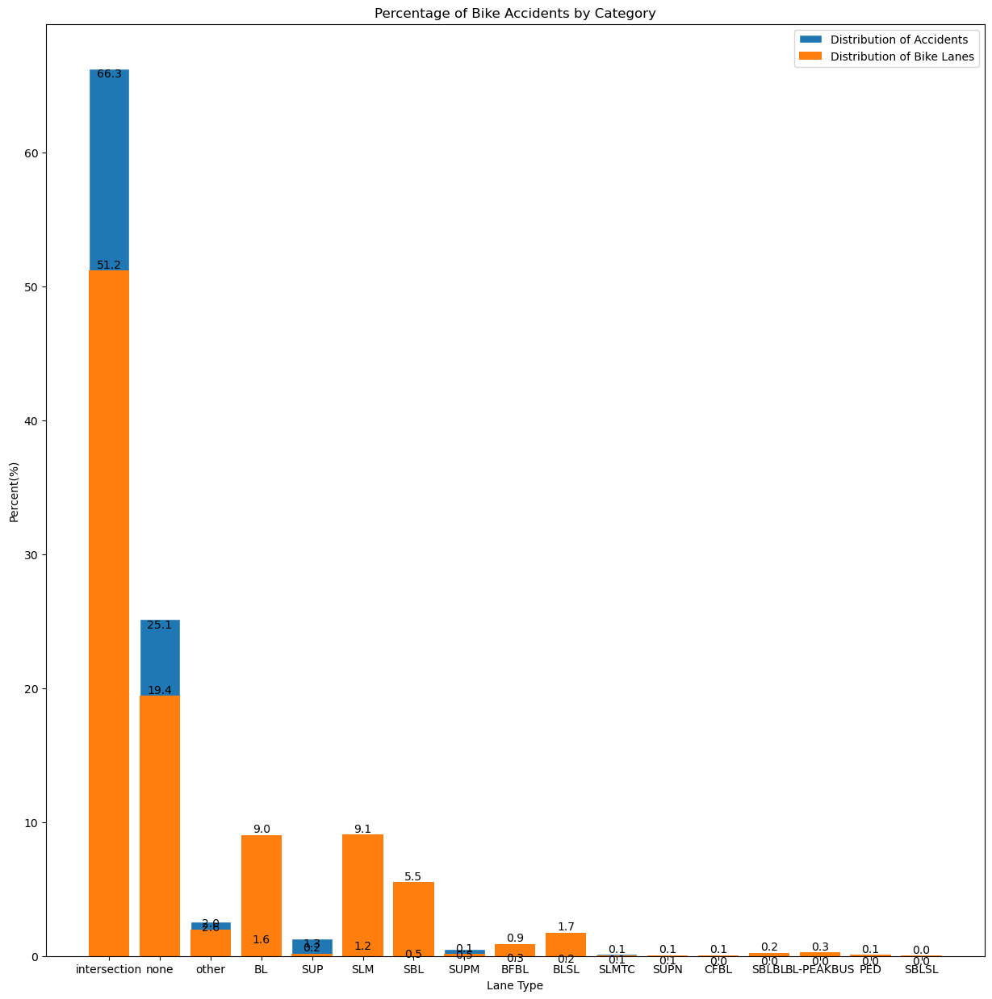

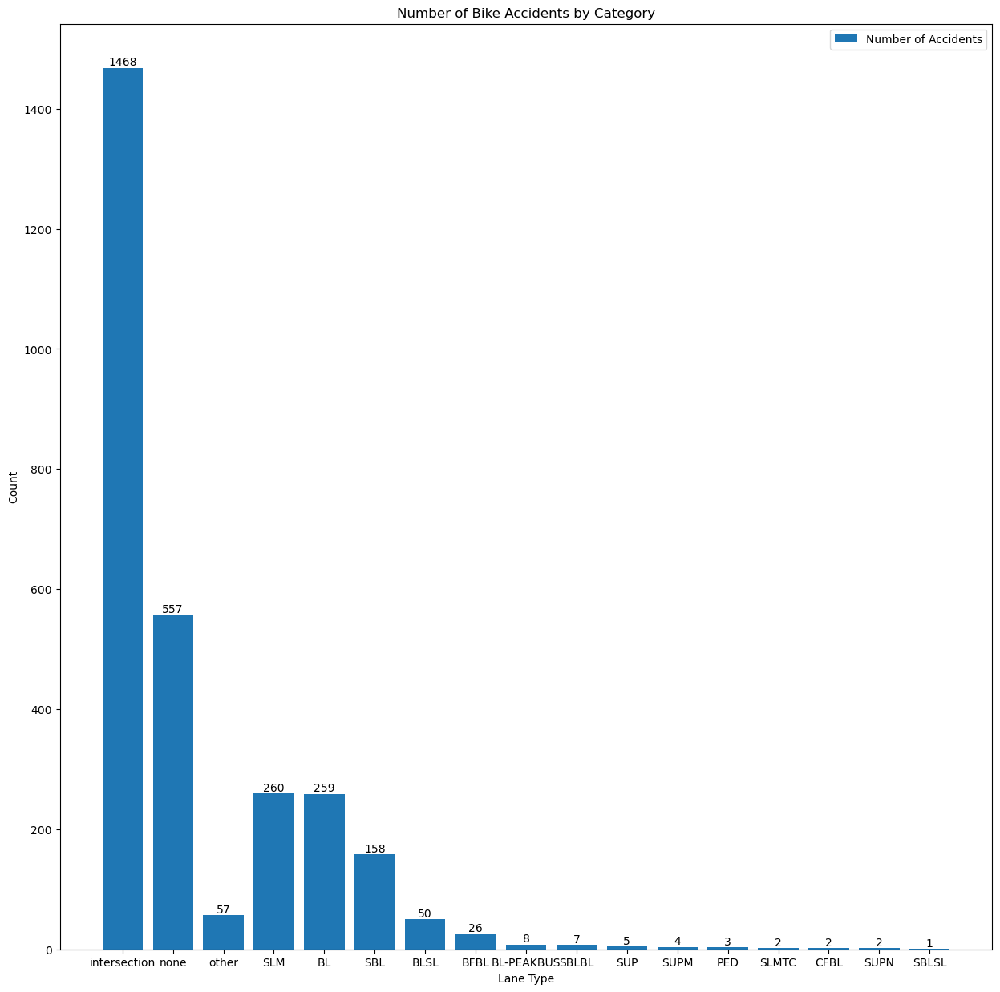

In [2]:
import accidents_by_lane
accidents_url = ("https://data.boston.gov/api/3/action/datastore_search?resource_id"
    + "=e4bfe397-6bfc-49c5-9367-c879fac7401d&limit=49000")
bike_lane_url = ("https://data.boston.gov/api/3/action/datastore_search?resource_id" +
       "=14e7e1a7-ffe0-4ae7-a6b4-3975fa32e879&limit=49000")
accidents_by_lane.visualize_data(accidents_url, bike_lane_url)

_The definitions to the elements of the X axis are as follows:_
- _BFBL = Buffered bike lane BL = Bike lane_
- _BLSL = Bike lane on one side, shared lane on the opposite side_
- _BSBL = Bus/bike lane_
- _CFBL = Contra-flow bike street_
-  _NSUP = Shared use path, natural surface_
- _NW = Neighborway, marked_
- _NW-U = Neighborway, unmarked_
- _SBL = Separated bike lane_
- _SBLBL = Separated bike lane on one side, bike lane on the opposite side_
- _SLM = Shared lane markings SRd = Shared road_
- _SUB = Shared use path bridge SUC = Shared use connector SUP = Shared use path_
- _TC = Traffic calmed street_
- _None = No bike lane_
- _Other = Occured on a trail_
- _Intersection = In the middle of a street intersection_

The first bar graph breaks down accidents by percent of total accidents(blue). It also includes a breakdown of bike lanes by length as a percent of the length of all roads in Boston(Orange). If all bike lanes have the same risk of accident then their distrubtion would be similar or equal to how much of Boston streets they make up. If they are more dangerous then the percent would be higher(Blue > Orange), and vice versa. 

The second bar graph shows the amount of accidents in each category to show the sheer amounts of accidents in each category.

What we can learn from these two graphs is that intersections are really, really dangerous. Actually, simply just not having any indiciation of bikes are really really dangerous. Even just having shared lane markings(SLM) to indicate to drivers that bikers on the roads significanntly lowers the amount of bicycle related accidents. Looking especially at bike paths, shared use paths(SUP/SUPM) are pretty dangerous. However, the lack of shared use paths in Boston might be skewing the results. Bike lanes(BL) are also comparitively more dangerous than SLMs or separated bike lanes(SBL). This is most likely due to the psycological aspect of having the share the road with a bike aswell as the physical lane barriers of SBLs.



## Conclusion
The data that we used could be potentially misleading. Accidents are counted by 911 calls, so a lesser accident or something that did not result in a call to 911 would not be counted here. The way we're quantifying data is also reductive. We only examined bike lanes based on total length, not speed of the road they are located next to, how much traffic these roads receive, or the level of repaire of the road. 

In addition, we had to do a lot of data manipulation to compare bike lane datasets to bike accidents. This mainly was around street names as they were recorded in different formats. We had to convert them to a common format, but might have missed some streets because we did not want to look through every single street name in Boston.

When looking at how to improve bike lanes, the better question to ask is how we can make crossing streets safer for bikes. Bike lanes are already really effective at minimizaing accidents. The vast majority happen in the middle of busy intersections when there are not clear indicators of bikers.

Despite this, this computational essay has provided a key insights into another dimension of Boston's transit infastrucute. A lot of attention is often diverted to the T, which is horrible, but bikes are often overlooked, yet another key aspect of reducing the carbon footprint of cities.